# NYC Restaurant Inspections 

02806 Social Data Analysis and Visualization <br>


Group members:
* JiaXin Wang, s230031
* ZiWei Chen, s212635
* XingGuang Geng, s212643 



--- 
# Table of Contents

* [1. Motivation](#sec1)
* [2. Basic Stats](#sec2)
* [3. Data Analysis](#sec3)
    * [3.1 Scores analysis](#sec3_1)
    * [3.2 Grades analysis](#sec3_2)
    * [3.3 Restaurants analysis](#sec3_3)
    * [3.4 Boros analysis](#sec3_4)
    * [3.5 Violation analysis](#sec3_5)
* [4. Genre](#sec4)
* [5. Visualizations](#sec5)
* [6. Discussion](#sec6)
* [7. Contributions](#sec7)

# 1. Motivation <a class="anchor" id="sec1"></a>


**Introduction** <br>

The focus of this study is on the DOHMH (Department of Health and Mental Hygiene) New York City Restaurant Inspection Results, which provides crucial information about food establishment inspections in the city. Given that the thriving food industry in New York City serves over 8 million people, ensuring food safety and quality is of utmost importance. The dataset contains valuable insights for multiple stakeholders, such as inspectors, restaurants, and customers. By analyzing the inspection results, we can uncover trends, patterns, and areas that need improvement. Furthermore, this study highlights the dataset's potential for promoting sustainability and creating a safer and healthier food industry environment for New York City residents. This information serves as a great motivation for my notebook.

**Dataset** <br>

The dataset used in this analysis is the DOHMH New York City Restaurant Inspection Results, which provides a comprehensive collection of inspection results for food establishments in New York City. This dataset comprises data from over 400,000 inspections conducted at more than 27,000 restaurants and food establishments across the city's five boroughs. Each inspection record includes essential information about the establishment, including the date, time, type of inspection, and the inspection outcome, which highlights the points deducted for any violations. This dataset offers a wealth of valuable information that can help identify areas that need improvement and promote a safer and healthier food industry environment in New York City.

**Objective** <br>

 In this research project, our primary objective is to unlock valuable insights from a complex dataset and make it more accessible to various stakeholders in the New York City restaurant industry. We aim to provide clear information about the DOHMH New York City Restaurant Inspection Results to inspectors, restaurants, and customers alike, highlighting the dataset's potential for improving food safety and quality. By analyzing the inspection results, we seek to identify patterns, trends, and areas for improvement that can promote a safer and healthier food industry environment in New York City. Ultimately, our goal is to showcase the dataset's value and encourage its use as a tool for promoting sustainability and ensuring public health.

# 2. Basic stats <a class="anchor" id="sec2"></a>

Before proceeding with the real analysis some data cleansing and preprocessing is done. First of all necessary packages are loaded.

In [2]:
#Import packages
import pandas as pd
import numpy as np
import folium
from folium.plugins import HeatMap
from folium import plugins
import random
from bokeh.io import output_notebook, show
from bokeh.models import ColumnDataSource, FactorRange, Legend
from bokeh.plotting import figure
from urllib.request import urlopen
import json
from scipy import stats
import matplotlib.pyplot as plt
from skimage import color, io, measure, img_as_ubyte 
import calplot
from datetime import datetime
import calendar 
import locale
from bokeh.plotting import figure, output_file, save
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plot
import seaborn as sb
import re
from matplotlib.ticker import PercentFormatter
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

The data represents the results of restaurant inspections conducted in New York City from 2011 to 2023. The data is retrived from the following page: [cityofnewyork.us](https://data.cityofnewyork.us/Health/DOHMH-New-York-City-Restaurant-Inspection-Results/43nn-pn8j).

In [3]:
# Load dataset
df = pd.read_csv('D://social pro/DOHMH_New_York_City_Restaurant_Inspection_Results.csv')

To get a quick overview of the type of data being used, you can look at the first few rows of the dataset.

In [4]:
df.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,...,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,Location Point1
0,50105856,NaN,Bronx,842,HUNTS POINT AVENUE,10474.0,9175290966,NaN,01/01/1900,NaN,...,NaN,40.817526,-73.888507,202.0,17.0,11502.0,2006424.0,2.027620e+09,BX27,NaN
1,50043179,SABA'S PIZZA,Manhattan,403,AMSTERDAM AVENUE,10024.0,2127871118,Jewish/Kosher,04/04/2023,Violations were cited in the following area(s).,...,Cycle Inspection / Initial Inspection,40.783346,-73.978164,107.0,6.0,16500.0,1031752.0,1.012100e+09,MN12,NaN
2,41708930,"SUBWAY, CARVEL",Queens,8651,BROADWAY,11373.0,7187790600,Sandwiches,03/30/2022,Violations were cited in the following area(s).,...,Cycle Inspection / Initial Inspection,40.737439,-73.877271,404.0,25.0,47300.0,4045397.0,4.018428e+09,QN29,NaN
3,50107723,ROMA PIZZA,Bronx,735,ALLERTON AVENUE,10467.0,7187984825,Pizza,10/31/2022,Violations were cited in the following area(s).,...,Cycle Inspection / Initial Inspection,40.865464,-73.865790,211.0,15.0,33800.0,2053637.0,2.045100e+09,BX07,NaN
4,50012357,ASTORIA COFFEE,Queens,3004,30TH ST,11102.0,3474107399,Coffee/Tea,01/02/2020,Violations were cited in the following area(s).,...,Cycle Inspection / Initial Inspection,40.766955,-73.922466,401.0,22.0,7300.0,4542099.0,4.005920e+09,QN71,NaN


It is important to clean the dataset before using it, as there are 27 columns and many of them contain empty or missing values. Cleaning the dataset will ensure that the data is accurate and consistent, which is necessary for conducting meaningful analysis.

**remove unrelevant columns**

Let's review all the columns in the dataset and examine the information contained in each to determine which columns can be combined or removed. It is important to consolidate or remove redundant or irrelevant columns to simplify the dataset and improve the efficiency of data analysis.

In [5]:
df.columns

Index(['CAMIS', 'DBA', 'BORO', 'BUILDING', 'STREET', 'ZIPCODE', 'PHONE',
       'CUISINE DESCRIPTION', 'INSPECTION DATE', 'ACTION', 'VIOLATION CODE',
       'VIOLATION DESCRIPTION', 'CRITICAL FLAG', 'SCORE', 'GRADE',
       'GRADE DATE', 'RECORD DATE', 'INSPECTION TYPE', 'Latitude', 'Longitude',
       'Community Board', 'Council District', 'Census Tract', 'BIN', 'BBL',
       'NTA', 'Location Point1'],
      dtype='object')

After analyzing the information contained in each column and considering our data analysis plan, we have decided to remove the following columns to optimize performance:
* Community Board
* PHONE
* BUILDING
* ZIPCODE
* Council District
* Census Tract
* BIN
* BBL
* NTA
* Location Point1
* GRADE DATE
* RECORD DATE

In [6]:
#Drop corresponding columns
df = df.drop(['Community Board','PHONE','BUILDING','ZIPCODE','Council District','Census Tract','BIN','BBL','NTA','Location Point1','GRADE DATE','RECORD DATE'],axis = 1)

Let's review the dataset after removing the specified columns to ensure that the changes have been made correctly.

In [7]:
df.head()

,CAMIS,DBA,BORO,STREET,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,INSPECTION TYPE,Latitude,Longitude
0,50105856,NaN,Bronx,HUNTS POINT AVENUE,NaN,01/01/1900,NaN,NaN,NaN,Not Applicable,NaN,NaN,NaN,40.817526,-73.888507
1,50043179,SABA'S PIZZA,Manhattan,AMSTERDAM AVENUE,Jewish/Kosher,04/04/2023,Violations were cited in the following area(s).,04L,Evidence of mice or live mice in establishment...,Critical,9.0,A,Cycle Inspection / Initial Inspection,40.783346,-73.978164
2,41708930,"SUBWAY, CARVEL",Queens,BROADWAY,Sandwiches,03/30/2022,Violations were cited in the following area(s).,10C,Lighting Inadequate,Not Critical,5.0,A,Cycle Inspection / Initial Inspection,40.737439,-73.877271
3,50107723,ROMA PIZZA,Bronx,ALLERTON AVENUE,Pizza,10/31/2022,Violations were cited in the following area(s).,04L,Evidence of mice or live mice in establishment...,Critical,18.0,NaN,Cycle Inspection / Initial Inspection,40.865464,-73.865790
4,50012357,ASTORIA COFFEE,Queens,30TH ST,Coffee/Tea,01/02/2020,Violations were cited in the following area(s).,02B,Hot food item not held at or above 140º F.,Critical,12.0,A,Cycle Inspection / Initial Inspection,40.766955,-73.922466


**Handling missing  values**

Since many columns still contain empty values, the next step is to process these values to avoid any potential impact on our data analysis.

Let's identify which columns contain empty values in the dataset.

In [8]:
# Identify whether or not that column contains any null or missing values
df.isnull().any()

CAMIS                    False
DBA                       True
BORO                     False
STREET                    True
CUISINE DESCRIPTION       True
INSPECTION DATE          False
ACTION                    True
VIOLATION CODE            True
VIOLATION DESCRIPTION     True
CRITICAL FLAG            False
SCORE                     True
GRADE                     True
INSPECTION TYPE           True
Latitude                  True
Longitude                 True
dtype: bool

As you can see from the previous output, there are only five columns that do not have any missing values. Therefore, we need to focus on processing the remaining columns that have missing values before proceeding with our data analysis.

Replace the missing values in the column **DBA** with the value **'Unnamed'** to make sure that every row has a value for this column.

In [9]:
#replace the missing value in column DBA with value 'Unnamed'
df['DBA'].fillna(value='Unnamed', inplace=True)

Remove all rows which have '0' values in the column **BORO** 

In [10]:
# find missing value 
df['BORO'].unique()

array(['Bronx', 'Manhattan', 'Queens', 'Brooklyn', 'Staten Island', '0'],
      dtype=object)

After examining the data, we have identified that the value '0' in the BORO column is an outlier. Therefore, we have decided to remove all rows that have a value of '0' in this column to ensure the integrity of our data analysis.

In [11]:
# remove rows with values is equal to '0'
df=df[df['BORO']!='0']

Lets check the cloumns again

In [12]:
df.isnull().any()

CAMIS                    False
DBA                      False
BORO                     False
STREET                   False
CUISINE DESCRIPTION       True
INSPECTION DATE          False
ACTION                    True
VIOLATION CODE            True
VIOLATION DESCRIPTION     True
CRITICAL FLAG            False
SCORE                     True
GRADE                     True
INSPECTION TYPE           True
Latitude                  True
Longitude                 True
dtype: bool

Replace all the  missing value in column **CUISINE DESCRIPTION** with value 'Other'

In [13]:
df['CUISINE DESCRIPTION'].fillna(value='Other', inplace=True)

In [14]:
df.isnull().any()

CAMIS                    False
DBA                      False
BORO                     False
STREET                   False
CUISINE DESCRIPTION      False
INSPECTION DATE          False
ACTION                    True
VIOLATION CODE            True
VIOLATION DESCRIPTION     True
CRITICAL FLAG            False
SCORE                     True
GRADE                     True
INSPECTION TYPE           True
Latitude                  True
Longitude                 True
dtype: bool

Let's take a look at a sub-dataset where all of the values in the **ACTION** column are missing.

In [15]:
df_ac_na = df[df['ACTION'].isnull()]   

In [16]:
df_ac_na

,CAMIS,DBA,BORO,STREET,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,INSPECTION TYPE,Latitude,Longitude
0,50105856,Unnamed,Bronx,HUNTS POINT AVENUE,Other,01/01/1900,NaN,NaN,NaN,Not Applicable,NaN,NaN,NaN,40.817526,-73.888507
7,50118016,Unnamed,Manhattan,GREENWICH STREET,Other,01/01/1900,NaN,NaN,NaN,Not Applicable,NaN,NaN,NaN,40.723646,-74.009506
9,50121058,MAD JUICY,Brooklyn,BUSHWICK AVENUE,Other,01/01/1900,NaN,NaN,NaN,Not Applicable,NaN,NaN,NaN,40.700738,-73.936490
12,50130677,RED RABBIT LLC,Queens,SKILLMAN AVE,Other,01/01/1900,NaN,NaN,NaN,Not Applicable,NaN,NaN,NaN,40.747196,-73.923417
21,50120244,VAN LEEUWEN ICE CREAM,Brooklyn,5 AVENUE,Other,01/01/1900,NaN,NaN,NaN,Not Applicable,NaN,NaN,NaN,40.673485,-73.982718
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204634,50114500,Unnamed,Brooklyn,KINGS HIGHWAY,Other,01/01/1900,NaN,NaN,NaN,Not Applicable,NaN,NaN,NaN,40.604251,-73.972713
204688,50128822,STARBUCKS,Queens,AIRPORT TERMINAL B,Other,01/01/1900,NaN,NaN,NaN,Not Applicable,NaN,NaN,NaN,NaN,NaN
204724,50112109,SUSHI FAMILY,Queens,UNION ST,Other,01/01/1900,NaN,NaN,NaN,Not Applicable,NaN,NaN,NaN,40.761531,-73.827072
204834,50134665,SPIRIT OF NEW JERSEY,Manhattan,CHELSEA PIERS,Other,01/01/1900,NaN,NaN,NaN,Not Applicable,NaN,NaN,NaN,40.747992,-74.008496


 Visualize the inspection date of the sub-dataset

<AxesSubplot:>

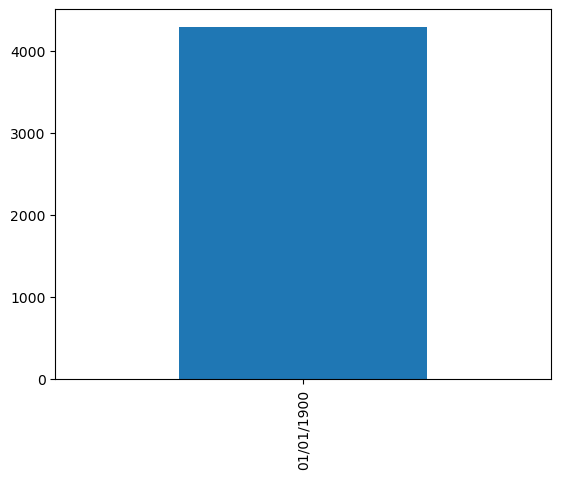

In [17]:
a = df_ac_na["INSPECTION DATE"].value_counts()
a.plot.bar()

As can be seen from the plot, all of the inspection dates in the sub-dataset appear to be on the same day, January 1st, 1900. This does not make sense because our dataset only contains dates ranging from 2011 to 2023. Moreover, we have found that when the value in the **"action"** column is missing, the corresponding value in the other 7 columns are also missing.

After visiting the official website of this dataset, we discovered that the date "1/1/1900" indicates that the establishment has not yet been inspected. Therefore, we have decided to exclude this data from our analysis.

In [18]:
df.dropna(subset=['ACTION'],inplace = True)

Nest step is to replace all of missing value in columns **VIOLATION CODE**, **VIOLATION DESCRIPTION**, **VIOLATION CODE** with value "-"

In [19]:
df['VIOLATION CODE'].fillna(value="-",inplace=True)
df['VIOLATION DESCRIPTION'].fillna(value="-",inplace=True)
df['VIOLATION CODE'].fillna(value="-",inplace=True)

In [20]:
df.isnull().any()

CAMIS                    False
DBA                      False
BORO                     False
STREET                   False
CUISINE DESCRIPTION      False
INSPECTION DATE          False
ACTION                   False
VIOLATION CODE           False
VIOLATION DESCRIPTION    False
CRITICAL FLAG            False
SCORE                     True
GRADE                     True
INSPECTION TYPE          False
Latitude                  True
Longitude                 True
dtype: bool

We have noticed that there are some empty values in the **"SCORE"** column of our dataset. Instead of removing these missing values, we have decided to replace them with the number -1.

In [21]:
df['SCORE'].fillna(value=-1,inplace=True)

In the case of missing values in the **"GRADE"** column, we have decided to use the corresponding "SCORE" values to replace them. This is because there is a grading mechanism that assigns grades to restaurants based on their scores. The grading system is straightforward: a score of 0-13 corresponds to an A grade, a score of 14-27 corresponds to a B grade, and a score of 28 and above corresponds to a C grade.

In [22]:
# Convert type of the column SCORE to numeric
df["SCORE"]=pd.to_numeric(df["SCORE"],errors="coerce")

In [23]:
# assing grade to each missing value in the  column Grade base on score
df.loc[(df.GRADE.isnull())&(df.SCORE<=13)&(df.SCORE>=0),'GRADE']='A'
df.loc[(df.GRADE.isnull())&(df.SCORE<=27)&(df.SCORE>=14),'GRADE']='B'
df.loc[(df.GRADE.isnull())&(df.SCORE>=28),'GRADE']='C'
df.loc[(df.GRADE.isnull())&(df.SCORE<0),'GRADE']='N'

In [24]:
df.isnull().any()

CAMIS                    False
DBA                      False
BORO                     False
STREET                   False
CUISINE DESCRIPTION      False
INSPECTION DATE          False
ACTION                   False
VIOLATION CODE           False
VIOLATION DESCRIPTION    False
CRITICAL FLAG            False
SCORE                    False
GRADE                    False
INSPECTION TYPE          False
Latitude                  True
Longitude                 True
dtype: bool

In the case of missing values in the "Lat" and "Lon" columns, we have decided to replace them with 0.

In [25]:
df.loc[df.Latitude.isnull(), 'Latitude']=0
df.loc[df.Longitude.isnull(), 'Longitude']=0

Finally, each columns do not any missing values

In [26]:
df.isnull().any()

CAMIS                    False
DBA                      False
BORO                     False
STREET                   False
CUISINE DESCRIPTION      False
INSPECTION DATE          False
ACTION                   False
VIOLATION CODE           False
VIOLATION DESCRIPTION    False
CRITICAL FLAG            False
SCORE                    False
GRADE                    False
INSPECTION TYPE          False
Latitude                 False
Longitude                False
dtype: bool

To enable a more thorough anaysis of dataset, we have decided to add additional three columns: 
* YEAR:  Indicate the year of each inspection.
* MONTH: Indicate the month of each inspection.
* SEASON: Indicate the season of each inspection, include spring, summer, fall and winter

Add columns **YEAR** and **MONTH**

In [27]:
df["YEAR"] = df["INSPECTION DATE"].apply(lambda x:x.split('/')[2])
df['MONTH' ]= df["INSPECTION DATE"].apply(lambda x:x.split('/')[0])

Add columns **SEASON**

In [28]:
#  create a dict to store month and corresponding season
season_dict = {}

# store month from 1 to 12 and corresponding season
for i in range(1,13):
    if i > 2 and i < 6:
        season_dict['0'+str(i)] = "Spring"
    elif i > 2 and i < 9:
        season_dict['0'+str(i)] = "Summer"
    elif i > 2 and i < 12:
        if i == 9:
            season_dict['0'+str(i)]="Fall"
        else:  
            season_dict[str(i)] = "Fall"
    else:
        if i == 1 or i == 2:
            season_dict['0'+str(i)]="Winter"
        else:
            season_dict[(str(i))] = "Winter"
            
# map season to each row based on month    
df["SEASON"] = df["MONTH"].map(season_dict)

In [29]:
df.head()

,CAMIS,DBA,BORO,STREET,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,INSPECTION TYPE,Latitude,Longitude,YEAR,MONTH,SEASON
1,50043179,SABA'S PIZZA,Manhattan,AMSTERDAM AVENUE,Jewish/Kosher,04/04/2023,Violations were cited in the following area(s).,04L,Evidence of mice or live mice in establishment...,Critical,9.0,A,Cycle Inspection / Initial Inspection,40.783346,-73.978164,2023,04,Spring
2,41708930,"SUBWAY, CARVEL",Queens,BROADWAY,Sandwiches,03/30/2022,Violations were cited in the following area(s).,10C,Lighting Inadequate,Not Critical,5.0,A,Cycle Inspection / Initial Inspection,40.737439,-73.877271,2022,03,Spring
3,50107723,ROMA PIZZA,Bronx,ALLERTON AVENUE,Pizza,10/31/2022,Violations were cited in the following area(s).,04L,Evidence of mice or live mice in establishment...,Critical,18.0,B,Cycle Inspection / Initial Inspection,40.865464,-73.865790,2022,10,Fall
4,50012357,ASTORIA COFFEE,Queens,30TH ST,Coffee/Tea,01/02/2020,Violations were cited in the following area(s).,02B,Hot food item not held at or above 140º F.,Critical,12.0,A,Cycle Inspection / Initial Inspection,40.766955,-73.922466,2020,01,Winter
5,50081684,BB JUICE BAR,Bronx,EAST 149 STREET,"Juice, Smoothies, Fruit Salads",07/29/2022,Establishment re-opened by DOHMH.,-,-,Not Applicable,0.0,Z,Cycle Inspection / Reopening Inspection,40.816168,-73.918048,2022,07,Summer


Let's take a look at the pattern of our dataset for the year after cleaning.

**Inspections by year**

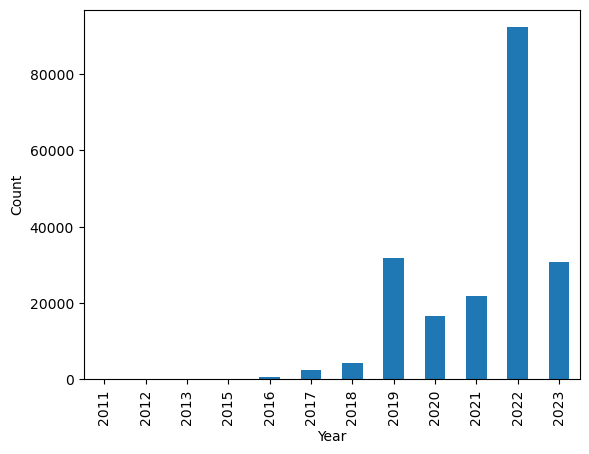

In [30]:
count = df.groupby('YEAR').size()
count.plot.bar()
plt.xlabel('Year')
plt.ylabel('Count')
plt.show()

We can see steady increase in the number of inspections recorded in the dataset from 2011 to 2019. This could be attributed to the following reasons:

* More inspections are being recorded and entered into the system
* The number of restaurants in NewYork city has increased over years
* The Health Department has become stricter and is conducting more inspections

Another notable finding is the significant decrease in the number of inspections in the year 2020 as compared to the previous year. This can be attributed to the COVID-19 pandemic, which resulted in the closure of many restaurants and irregular inspections. However, in the year 2022, we can observe a sharp increase in the number of inspections, indicating a post-pandemic recovery as restaurants reopen.

modify data so that each restaurant will only show up one time for each year

**Data Modification**

The dataset contains **24,013** establishments identified by a unique CAMIS ID. However, it also includes multiple rows with the same CAMIS ID. This is because establishments have undergone multiple inspections over the years, resulting in each row representing a single restaurant-inspection pair. Consequently, a single restaurant could have multiple rows with different grades, which would not provide an accurate picture of the restaurant's performance if we were to analyze the data based on grades. To address this issue, we need to filter the data to retain only the most recent restaurant-inspection pair for each year. Therefore, we will create another dataset that includes only the most recent inspection for each restaurant in each year. In summary, the reasons as following:

* Although a single restaurant may have multiple rows with varying grades, it is necessary for us to consider only the most recent inspection date for each restaurant in a given year.

* This dataset can be utilized to identify patterns among restaurants cause each restaurant only display once in each year



In [31]:
print(f"There are {len(df['CAMIS'].unique())} unique restaurants in the dataset.")

There are 24013 unique restaurants in the dataset.



Let's begin by creating a dataset that only contains the latest inspection record for each restaurant in every year.

In [32]:
# cory the dataset
df_test = df.copy()

# convert the type of column DATE to DateTime
df_test['DATE'] = pd.to_datetime(df_test['INSPECTION DATE'])

# display the most recent inspection for each restaurant in each year
df_test_new = df_test.groupby(['CAMIS','YEAR']).apply(lambda x:x.loc[x['DATE'].idxmax()]).reset_index(drop=True)

In [33]:
df_test_new 

,CAMIS,DBA,BORO,STREET,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,INSPECTION TYPE,Latitude,Longitude,YEAR,MONTH,SEASON,DATE
0,30075445,MORRIS PARK BAKE SHOP,Bronx,MORRIS PARK AVENUE,Bakery Products/Desserts,08/10/2021,Violations were cited in the following area(s).,06E,"Sanitized equipment or utensil, including in-u...",Critical,5.0,A,Cycle Inspection / Initial Inspection,40.848231,-73.855972,2021,08,Summer,2021-08-10
1,30075445,MORRIS PARK BAKE SHOP,Bronx,MORRIS PARK AVENUE,Bakery Products/Desserts,02/03/2023,Establishment re-opened by DOHMH.,10F,Non-food contact surface or equipment made of ...,Not Critical,13.0,Z,Cycle Inspection / Reopening Inspection,40.848231,-73.855972,2023,02,Winter,2023-02-03
2,30112340,WENDY'S,Brooklyn,FLATBUSH AVENUE,Hamburgers,08/05/2021,Violations were cited in the following area(s).,04N,Filth flies or food/refuse/sewage-associated (...,Critical,16.0,B,Cycle Inspection / Re-inspection,40.662652,-73.962081,2021,08,Summer,2021-08-05
3,30112340,WENDY'S,Brooklyn,FLATBUSH AVENUE,Hamburgers,07/13/2022,Violations were cited in the following area(s).,10F,Non-food contact surface or equipment made of ...,Not Critical,11.0,A,Cycle Inspection / Initial Inspection,40.662652,-73.962081,2022,07,Summer,2022-07-13
4,30191841,DJ REYNOLDS PUB AND RESTAURANT,Manhattan,WEST 57 STREET,Irish,06/06/2019,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Critical,8.0,A,Cycle Inspection / Initial Inspection,40.767326,-73.984310,2019,06,Summer,2019-06-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47683,50134080,RED BEAR,Bronx,MACE AVENUE,Coffee/Tea,03/31/2023,Violations were cited in the following area(s).,05F,"Insufficient or no hot holding, cold storage o...",Critical,31.0,N,Pre-permit (Non-operational) / Initial Inspection,40.862760,-73.843847,2023,03,Spring,2023-03-31
47684,50134092,BRICK WINE BAR,Manhattan,CLINTON STREET,American,04/03/2023,Violations were cited in the following area(s).,10A,Toilet facility not maintained or provided wit...,Not Critical,7.0,N,Pre-permit (Non-operational) / Initial Inspection,40.720676,-73.984253,2023,04,Spring,2023-04-03
47685,50134094,SHAWARMA VS FALAFEL,Manhattan,BROOME STREET,Mediterranean,04/03/2023,Violations were cited in the following area(s).,10F,Non-food contact surface or equipment made of ...,Not Critical,4.0,N,Pre-permit (Non-operational) / Initial Inspection,40.718000,-73.989813,2023,04,Spring,2023-04-03
47686,50134101,TIENDA GUATEMALTECA EL QUETZALITO,Brooklyn,5 AVENUE,Spanish,04/03/2023,Violations were cited in the following area(s).,06A,Personal cleanliness is inadequate. Outer garm...,Critical,60.0,N,Pre-permit (Operational) / Initial Inspection,40.642186,-74.013336,2023,04,Spring,2023-04-03


Let's take a look at the pattern of our new dataset

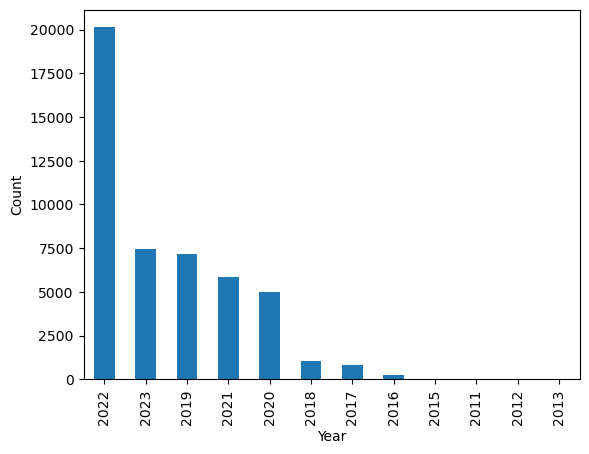

In [34]:
year_count = df_test_new ['YEAR'].value_counts()

year_count.plot.bar()
plt.xlabel('Year')
plt.ylabel('Count')
plt.show()

As we can observe from the plot above, the year 2022 has the highest number of restaurants. Therefore, we have decided to concentrate on this year for our data analysis. There are several reasons for this choice, which include:

* This year has the highest number of restaurants,thus this year's dataset contains more comprehensive information, which is advantageous for us to analyze the data.

* Our objective is to analyze the latest inspection data of restaurants. Moreover, 2022 is a more appropriate year to use for our analysis than 2023, as the data for 2023 is incomplete since we are currently in the middle of the year.

* Although we are primarily focusing on the data from 2022, we will utilize the complete dataset for analysis whenever it is deemed necessary.

In [35]:
# make a dataset only contians inspections in year 2022
df_test_22 = df_test_new[df_test_new["YEAR"]=='2022']

Ultimately, we will be employing two datasets for our subsequent analysis. The first dataset is named **'df'** and includes the complete inspection records, while the second dataset, **'df_test_22'**, only comprises the inspection records from the year 2022.

# 3: Data analysis <a class="anchor" id="sec3"></a>

In this section, we will delve into the various aspects of food safety inspections in New York City restaurants by analyzing different datasets. Our analysis aims to provide valuable insights for regulatory authorities, restaurant owners, and customers to better understand the food safety landscape and work together to improve industry standards. The data analysis will cover the following topics: score analysis, grade analysis, borough analysis, cuisine analysis, and violation analysis. By examining these areas, we aim to reveal trends, common issues, and opportunities for improvement, while fostering a culture of continuous growth and excellence in food safety practices.

## 3.1 Scores analysis<a class="anchor" id="sec3_1"></a>


In the score analysis section, we will investigate the distribution of inspection scores and their correlation with various factors, such as boroughs and cuisine types. This analysis will help to identify potential trends and disparities in food safety performance across different regions and cuisines. By understanding these patterns, stakeholders can focus their efforts on addressing specific areas of concern and work towards ensuring a consistently high level of food safety across all establishments.

Before delving into the score analysis, let's first take a look at the distribution of inspection scores across New York City restaurants. The following chart will provide us with an overview of the range and frequency of scores, setting the stage for our deeper analysis.

D:\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Distribution Plot of the Scores')

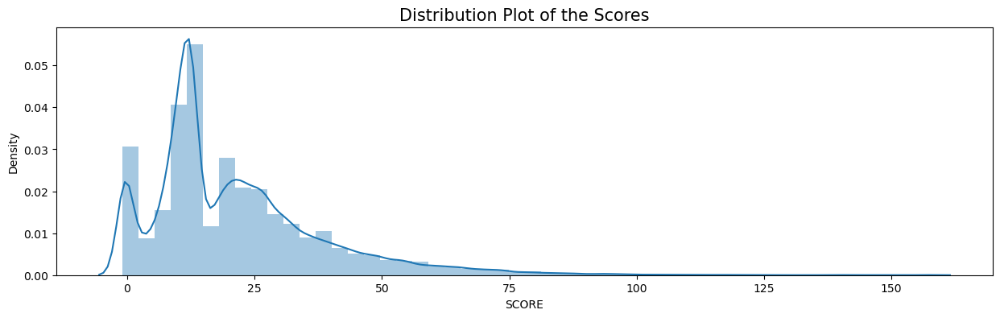

In [36]:
fig, ax = plt.subplots()
fig.set_size_inches(15, 4)
sns.distplot(df.SCORE)
plt.title("Distribution Plot of the Scores", fontsize=15)

The chart shows that most scores are concentrated at 25 and below, with the highest density of restaurants scoring 12, followed by those with a score of 0. This indicates that a majority of the restaurants perform well in health inspections and comply with hygiene requirements. However, as the scores increase, the number of restaurants decreases, suggesting that some restaurants have significant hygiene issues. 

Here are some suggestions:

***For regulatory authorities***:
Focus on restaurants with higher scores (above 25), subjecting them to stricter supervision and inspections.
Analyze common issues in high-scoring restaurants, develop targeted remediation measures and training programs to improve restaurant hygiene levels.

***For customers***:
When choosing a restaurant, pay attention to the health inspection scores, and opt for restaurants with lower scores (25 and below).
Utilize online platforms and official channels to stay informed about the hygiene situation of restaurants, reducing food safety risks associated with unsanitary dining environments.

***For restaurant owners***:
Conduct regular self-inspections to ensure effective implementation of hygiene standards.
Learn from the experiences and practices of restaurants with lower scores to enhance your own restaurant's hygiene levels, aiming for a lower score in the next health inspection.
For restaurants with higher scores, pay special attention to the issues identified in health inspections, take corrective actions, and improve the overall hygiene conditions of the restaurant.

In the next chart, we will examine the distribution of scores in relation to the A, B, and C grade classifications, providing insights into the performance of restaurants across different grade categories.
This distribution has a very long tail. Let's set a cutoff with a maximum score of 50.

In [37]:
trimscore = df[df.SCORE <= 50]

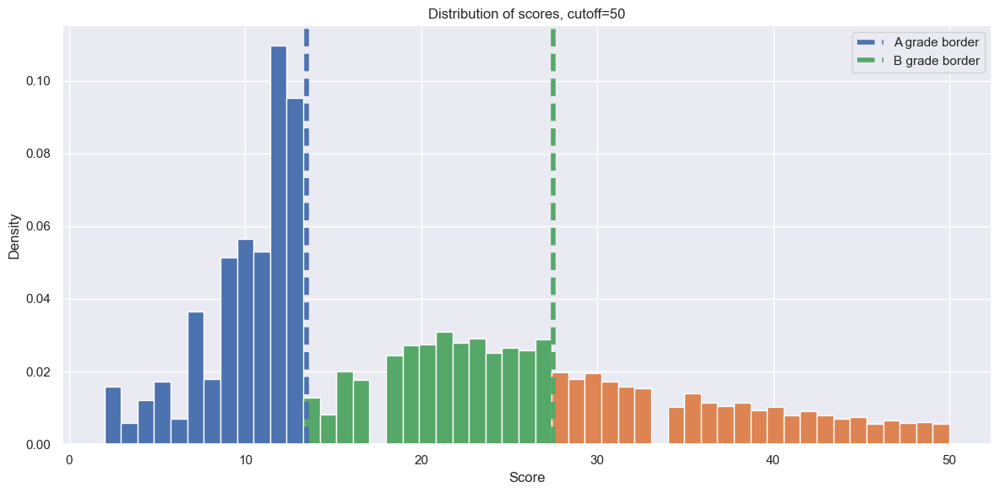

In [38]:
plt.style.use('ggplot')
sns.set(style='darkgrid')
green = (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)
orange = (0.8666666666666667, 0.5176470588235295, 0.3215686274509804)

fig, ax = plt.subplots(figsize = (12,6))
N, bins, patches = ax.hist(trimscore.SCORE[trimscore.SCORE> 0], bins = 51, density=True)
ax.axvline(x= 13.5, linestyle='--', linewidth=4, color='b', label='A grade border')
ax.axvline(x= 27.5, linestyle='--', linewidth=4, color=(0.3333333333333333, 0.6588235294117647, 0.40784313725490196), label='B grade border')
ax.legend()
ax.set_xlabel('Score')
ax.set_ylabel('Density')
ax.set_title('Distribution of scores, cutoff=50')

    
for i in range(12,27):
    patches[i].set_facecolor(green)
for i in range(27, 51):
    patches[i].set_facecolor(orange)

plt.tight_layout()

# plt.savefig('img/scoredist.png')
plt.show()

The chart above presents the distribution of health inspection scores with a cutoff at 50 for restaurants in New York City, categorized by A (blue), B (green), and C (yellow) grades. The grading system is straightforward: a score of 0-13 corresponds to an A grade, a score of 14-27 corresponds to a B grade, and a score of 28 and above corresponds to a C grade.

The chart reveals several key insights:

1. A significant number of restaurants achieve A grades, with the highest density of A grade restaurants at a score of 12 (above 0.1) and a density of approximately 0.095 at a score of 13. This suggests that a large proportion of establishments in New York City adhere to strict hygiene standards, offering customers a safe dining experience.

2. B grade restaurants mainly have a density between 0.02 and 0.03, indicating that although these establishments meet the minimum hygiene requirements, there is room for improvement. Further analysis of the specific violations in these restaurants can help identify the areas that need attention, enabling the development of targeted intervention strategies.

3. C grade restaurants, represented by yellow bars, have a density lower than 0.02, decreasing as the score increases. The low density of C grade establishments suggests that only a small proportion of restaurants have severe hygiene issues. However, the presence of these restaurants indicates the need for continuous monitoring and strict enforcement of food safety regulations to protect public health.

So for regulatory authorities, it is essential to consistently monitor C grade restaurants, ensuring they take corrective actions to address identified issues and considering the implementation of stricter penalties or closure for those that fail to improve their hygiene standards. Additionally, authorities should develop targeted intervention strategies and training programs for B grade restaurants to help them improve their hygiene levels and progress toward an A grade, which may involve workshops, online resources, and expert consultations. Moreover, recognizing and rewarding A grade restaurants for maintaining high standards of hygiene and food safety is crucial in promoting a culture of excellence within the industry.

With a better understanding of inspection scores, we will now explore how cuisine types may influence these scores. This analysis will reveal any trends or disparities in food safety performance among different types of restaurants. In the next chart, we will analyze the distribution of violation scores across various cuisine types.

In [39]:
# Create box plot with color mapped to GRADE
fig = px.box(df, x='BORO', y='SCORE',color='BORO',           
             color_discrete_sequence=['red', 'orange', 'green'],         
             title='Score distribution by grades',
             labels={'GRADE': 'Grade', 'SCORE': 'Violation Score'},
             width=800, height=500)
fig.show()


The chart above presents a box plot comparing the distribution of violation scores across different boroughs in New York City: Manhattan, Queens, Bronx, Brooklyn, and Staten Island. The differences in violation scores within and between boroughs suggest varying levels of food safety compliance in these areas.

1. Staten Island has the lowest median violation score and a relatively smaller range between the lower and upper quartiles, indicating better overall compliance with food safety regulations and more consistent hygiene standards compared to other boroughs. This might be due to a smaller number of restaurants, closer-knit communities, or more effective enforcement.

2. Brooklyn has the highest median violation score among the boroughs, suggesting room for improvement in maintaining hygiene standards. Queens shares a similar median score with Bronx, but it has a slightly larger range between the lower and upper quartiles, indicating more variation in restaurant hygiene levels.

3. Manhattan, despite having a slightly lower median violation score than Brooklyn, Queens, and Bronx, has a wide range of scores, with some establishments performing exceptionally well and others struggling to meet food safety standards.

Suggestions:
1. For regulatory authorities:
   - Focus on providing additional support and resources to restaurants in Brooklyn, where the median violation score is the highest among the boroughs, and in Queens, where the range of scores is larger.
   - Prioritize inspections and targeted interventions for establishments with consistently high violation scores in Manhattan.
   - Share best practices and success stories from Staten Island with restaurants in other boroughs, fostering a culture of collaboration and continuous improvement.

2. For customers:
   - When choosing dining options, consider the overall food safety performance of restaurants in each borough, while also taking into account individual establishment inspection scores.
   - Encourage local restaurants to improve their food safety practices by providing feedback and supporting establishments that prioritize hygiene and cleanliness.

3. For restaurant owners:
   - Collaborate with other restaurant owners in your borough to share best practices, learn from each other's experiences, and identify common challenges related to food safety compliance.
   - Proactively seek guidance and resources from regulatory authorities, industry experts, and fellow restaurant owners to address areas of concern in your establishment, ensuring that your restaurant maintains high hygiene standards.

Having explored the distribution of inspection scores by grade, let's now turn our attention to the relationship between these scores and the various types of cuisines served in New York City restaurants. This will help us identify any potential trends or disparities in food safety performance among different cuisine types, which can inform targeted intervention and support strategies. In the following charts, we will analyze the distribution of violation scores across diverse cuisines and discuss the implications of our findings.

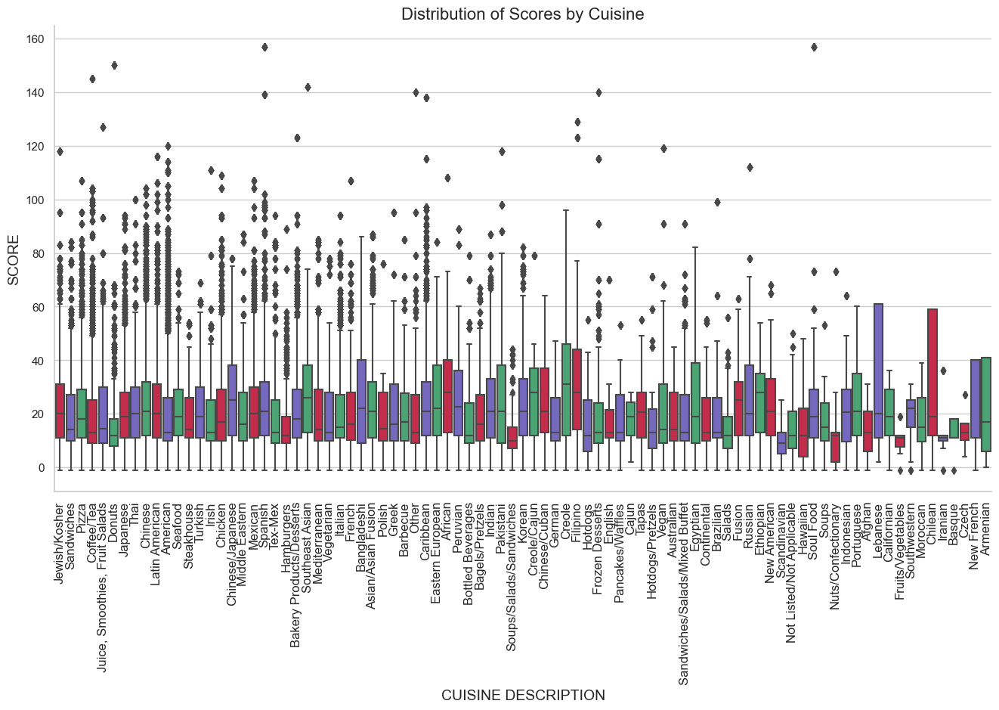

In [40]:
# Set plot style
sns.set_style("whitegrid")

# Set figure size
plt.figure(figsize=(16, 8))

# Create boxplot
sns.boxplot(x='CUISINE DESCRIPTION', y='SCORE', data=df, palette=['crimson', 'slateblue', 'mediumseagreen'])

# Add x-label and rotate tick labels
plt.xlabel("CUISINE DESCRIPTION", fontsize=14)
plt.xticks(rotation=90, fontsize=12)

# Add y-label and set font size
plt.ylabel("SCORE", fontsize=14)

# Add title and set font size
plt.title("Distribution of Scores by Cuisine", fontsize=16)

# Add plot border
sns.despine()

# Display plot
plt.show()


The chart illustrates the distribution of violation scores across 87 different cuisines in New York City. The Y-axis represents the violation scores, while the X-axis indicates the cuisine types. The plot reveals noteworthy patterns and trends among various cuisines concerning food safety compliance.

1. The cuisines with the highest maximum violation scores are Spanish and Soul Food, indicating that some establishments in these categories have significant food safety issues that need to be addressed.

2. Soups/Salads/Sandwiches and Scandinavian cuisines have the lowest average violation scores, suggesting that restaurants serving these cuisines generally adhere to higher hygiene standards.

3. Cuisines such as American, Coffee/Tea, Pizza, Japanese, Chinese, Spanish, Caribbean, Mexican, and Latin American exhibit a wide range of violation scores, indicating that some establishments maintain high hygiene standards while others struggle with food safety compliance.

4. Iranian cuisine represents the least common type of restaurant, followed by Fruits/Vegetables and Czech. The limited number of establishments in these categories might be due to various factors, such as market demand or cultural preferences.

5. Creole cuisine has the highest average violation score, followed by Creole/Cajun, Filipino, African, Southeast Asian, and Chinese/Japanese. This suggests that restaurants serving these cuisines might require additional guidance and support to improve their food safety practices.

6. Polish, German, English, Cajun, Scandinavian, Afghan, and Basque cuisines have no high outliers and relatively low average violation scores, indicating that establishments serving these cuisines generally maintain good hygiene standards.

Suggestions:
1. For regulatory authorities:
   - Prioritize inspections and interventions for cuisines with higher average violation scores or wider score ranges, such as Creole, Spanish, Soul Food, and American, to address food safety issues more effectively.
   - Offer targeted training and resources to restaurants serving cuisines with higher violation scores or those struggling with food safety compliance, such as Creole/Cajun, Filipino, African, Southeast Asian, and Chinese/Japanese.
   - Encourage collaboration and sharing of best practices among restaurants serving different cuisines to promote a culture of continuous improvement in food safety and hygiene standards.

2. For customers:
   - Research and familiarize yourself with the food safety inspection scores of restaurants serving different cuisines before making dining choices.
   - Share your experiences and concerns about food safety and hygiene with restaurant owners and staff, providing constructive feedback to help them improve their practices.
   - Actively promote and recommend restaurants that consistently maintain high hygiene standards, incentivizing other establishments to prioritize food safety.

3. For restaurant owners:
   - Regularly review and analyze your establishment's food safety inspection scores, identifying areas of improvement and implementing corrective actions as needed.
   - Network with other restaurant owners serving similar cuisines and participate in industry events, workshops, and seminars to stay informed about food safety trends, regulations, and best practices.
   - Invest in employee training, focusing on food handling, storage, and preparation techniques to ensure compliance with food safety regulations.
   - Establish a system for monitoring and maintaining the cleanliness and hygiene of your restaurant, including regular inspections, cleaning schedules, and staff responsibilities.
   - Seek feedback from customers on their perceptions of your restaurant's hygiene and food safety practices, using this information to make improvements and address any concerns.

## 3.2 Grades analysis<a class="anchor" id="sec3_2"></a>

Building on the insights from the score analysis, we now shift our focus to understanding the distribution of restaurant grades, which can provide a more granular view of food safety compliance in the industry. The grade analysis complements the score analysis by giving stakeholders a clear picture of the performance of individual establishments and the overall food safety landscape in New York City.


Building on the insights from the score analysis, we now shift our focus to understanding the distribution of restaurant grades, which can provide a more granular view of food safety compliance in the industry. The grade analysis complements the score analysis by giving stakeholders a clear picture of the performance of individual establishments and the overall food safety landscape in New York City. With this foundation laid, let's proceed to examine the distribution of restaurant grades in New York City, presenting a comprehensive overview of the proportion of restaurants receiving A, B, and C grades. By understanding the distribution of these grades, stakeholders can better assess the overall food safety performance of the industry and identify areas for improvement or targeted intervention. The upcoming chart will shed light on the prevalence of high-performing establishments as well as those that need to enhance their food safety compliance efforts.

In [41]:
# group the data by unique grades and calculate the frequency of each grade
tmp = pd.DataFrame(df_test_22.groupby(['GRADE']).size().reset_index(name='Freq'))
tmp = pd.DataFrame(tmp.groupby(['GRADE'])['Freq'].sum().reset_index())

# convert the frequency to a percentage
tmp['Percent'] = tmp['Freq'] * 100 / tmp['Freq'].sum()

p = px.bar(tmp, x='GRADE', y='Percent', title='Grade percentage')
p.update_layout(xaxis_title='Grade', yaxis_title='Percentage', yaxis_range=[0, 100], yaxis_ticksuffix='%')
p.show()


The chart displays the distribution of restaurant grades as a percentage of the total number of establishments. The X-axis represents the different grades (A, B, C, N, P, and Z), while the Y-axis shows the corresponding percentage of restaurants with each grade.

The majority of restaurants (69.7%) have received an A grade, reinforcing the findings from the score analysis that a significant proportion of establishments in New York City maintain high hygiene and food safety standards. B and C grades, representing 13.4% and 7.8% of restaurants respectively, highlight the need for targeted intervention and support to help these establishments improve their food safety compliance. N (6.3%) and Z (2.6%) grades are less common and are assigned to restaurants that are either new or have pending inspection results. The dataset does not include any restaurants with a P grade.

Now that we have examined the distribution of restaurant grades in New York City, we will further explore how violation scores vary among establishments with different grades. The following chart will compare the violation scores for A, B, and C-grade restaurants, providing a deeper understanding of the extent to which food safety compliance differs across these categories. By connecting the insights from both the grade distribution and this upcoming analysis, stakeholders can gain a more comprehensive view of the food safety landscape and develop targeted strategies to address specific areas of concern and drive improvements across the industry.

In [42]:
# Explode the unique values of GRADE and SCORE into individual rows
tmp = df_test_22.explode('GRADE').explode('SCORE')

# Filter for valid GRADE values and convert to ordered categorical
grade = ['C', 'B', 'A']
tmp = tmp[tmp['GRADE'].isin(grade) & (tmp['SCORE'] >= 0)]
tmp['GRADE'] = pd.Categorical(tmp['GRADE'], categories=grade, ordered=True)

# Create box plot with color mapped to GRADE
fig = px.box(tmp, x='GRADE', y='SCORE', color='GRADE',
             category_orders={'GRADE': grade},
             color_discrete_sequence=['red', 'orange', 'green'],
             points='all', notched=True,
             title='Score distribution by grades',
             labels={'GRADE': 'Grade', 'SCORE': 'Violation Score'},
             width=800, height=500)
fig.show()


Building on the insights from the score analysis and the grade distribution, the chart above presents the distribution of violation scores for A, B, and C-grade restaurants. This information offers valuable context for stakeholders to better understand the varying levels of food safety compliance across the industry.

In light of the grade analysis, the following targeted suggestions can be proposed for different stakeholders to foster a culture of continuous improvement and maintain high-quality dining experiences for customers:

1. Regulatory authorities:
   - Provide tailored support and resources to B and C-grade restaurants to help them elevate their food safety compliance and work towards achieving an A grade.
   - Promote knowledge sharing among establishments to encourage best practices and facilitate learning from top-performing restaurants.
   - Conduct regular inspections and follow-up on improvement efforts to ensure restaurants are held accountable for maintaining high food safety standards.

2. Customers:
   - Make informed dining choices based on the grades of restaurants, promoting a demand for higher food safety standards.
   - Provide feedback to restaurants on their food safety practices, encouraging transparency and improvement in the industry.

3. Restaurant owners:
   - Proactively review their restaurant's grade and violation scores, identifying areas for improvement and implementing necessary changes.
   - Collaborate with regulatory authorities and industry peers to learn from best practices and share experiences in achieving higher food safety standards.

By integrating the insights from both the score and grade analyses, stakeholders can work together to ensure high hygiene and food safety standards across the industry. This comprehensive approach to food safety compliance will contribute to an enhanced dining experience for customers, while also supporting the continuous improvement of establishments in New York City's vibrant food service sector.

## 3.3 Restaurants analysis <a class="anchor" id="sec3_3"></a>

<Figure size 2500x1400 with 0 Axes>

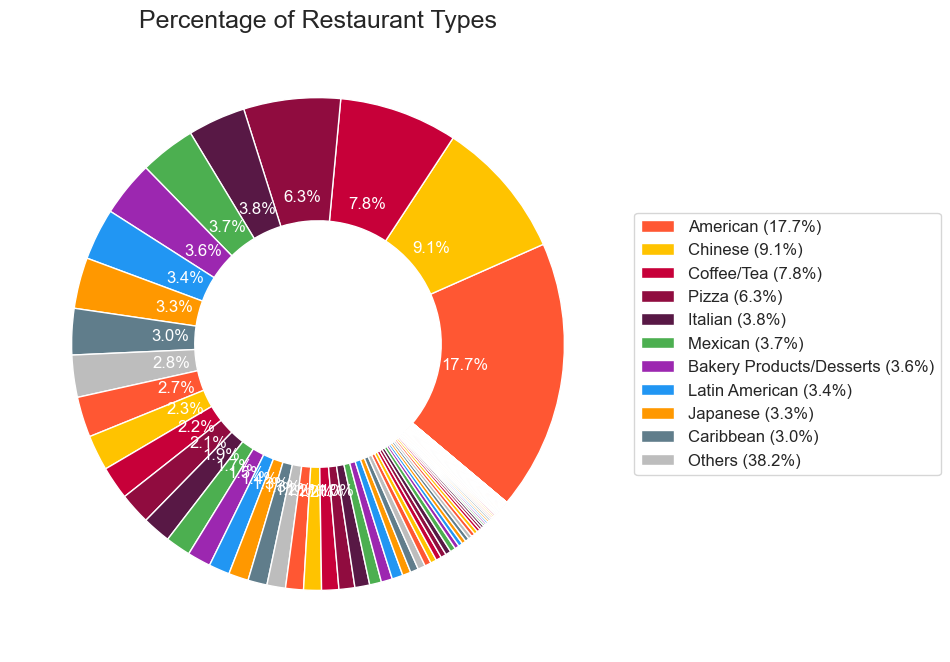

In [43]:
b = df_test_22.groupby(['CUISINE DESCRIPTION']).size()
fig = plt.figure(figsize=(25, 14))
# Calculate the percentage of each restaurant type
percentages = [100 * freq / sum(b.values) for freq in b.values]

# Sort the restaurant types and percentages by descending order
sorted_percentages, sorted_types = zip(*sorted(zip(percentages, b.keys()), reverse=True))

# Get the top 10 restaurant types and percentages
top10_percentages = sorted_percentages[:10]
top10_types = sorted_types[:10]

# Create a pie chart for the top 10 restaurant types and "others" group
fig, ax = plt.subplots(figsize=(10, 8))
colors = ['#FF5733', '#FFC300', '#C70039', '#900C3F', '#581845', '#4CAF50', '#9C27B0', '#2196F3', '#FF9800', '#607D8B', '#BDBDBD']

wedges, texts, autotexts = ax.pie(sorted_percentages, 
                                   wedgeprops=dict(width=0.5),
                                   textprops={'fontsize': 12, 'color': 'white'},
                                   colors=colors,
                                   autopct=lambda pct: f'{pct:.1f}%' if pct > 1 else '',
                                   startangle=-40)

# Add labels for the top 10 restaurant types and "others" group
labels = [f'{t} ({p:.1f}%)' for t, p in zip(top10_types, top10_percentages)]
labels.append(f'Others ({100 - sum(top10_percentages):.1f}%)')
ax.legend(wedges, labels, loc='center left', bbox_to_anchor=(1, 0.5), fontsize=12)

# Add title and legend
ax.set_title('Percentage of Restaurant Types', fontsize=18)

plt.show()



For restaurant analysis, we first looked at the pie chart showing the distribution of restaurant types in New York City and also for getting the top 10 restaurant types. 

American restaurants are the most common type, accounting for 17.7% of all restaurants, followed by Chinese restaurants at 9.1%. The remaining restaurant types with labels, include Coffee/Tea, Pizza, Italian, Mexican, Bakery, Latin American, Japanese, and Caribbean with the percentage ranging from less than 3% to 7.8%.

Note that restaurant types with a percentage of less than 3% do not appear with a label in the chart.

This information can be useful for those interested in the restaurant industry in New York City, such as consumers, business owners, and investors. It provides an overview of the types of restaurants available in the city and their relative popularity.

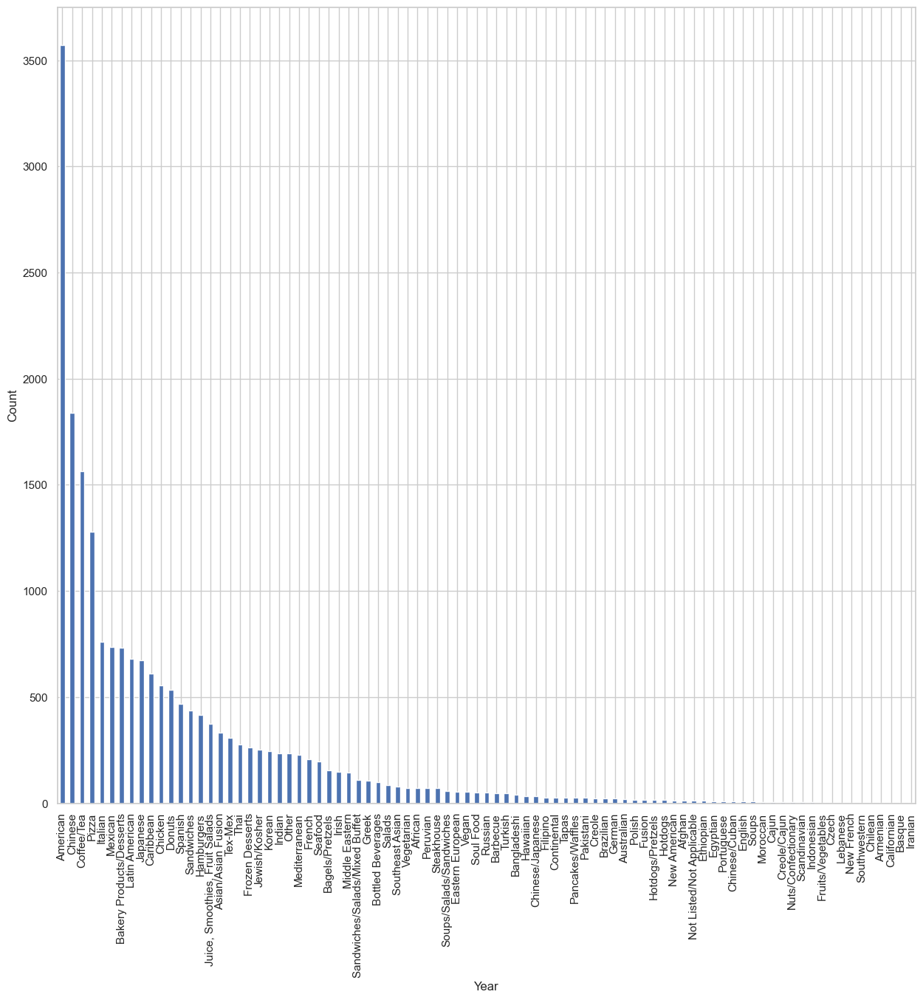

In [44]:
# create a series of value counts of unique cuisine descriptions in the dataframe
a = df_test_22['CUISINE DESCRIPTION'].value_counts()
fig = plt.figure(figsize=(15, 14))
# create a bar plot of the value counts
a.plot.bar()
plt.xlabel('Year')
plt.ylabel('Count')
plt.show()

From the bar chart above, we can see there is a wide variety of restaurants in New York City. The American restaurants ranks first in the number, which is about twice of the second much one. The number of Chinesee restaurants is about 18,000 as the second most common restaurants type. The third to tenth most types of restaurants are: Coffee/Tea, Pizza, Italian, Mexican, Bakery Products/Desserts, Latin American, Japanese, and Caribbean. The number of different types of restaurants shows a sharp difference.

Customers can use the chart to gain an understanding of the types of restaurants that are available in New York City. They can also use it to make informed decisions about where to eat based on their preferences. Restaurant owners can use the chart to gain an understanding of the competitive landscape in New York City. They can also use it to identify potential opportunities for growth or areas where they may need to differentiate their offerings.

Visualize the grade percentages in top 10 types of restaurant

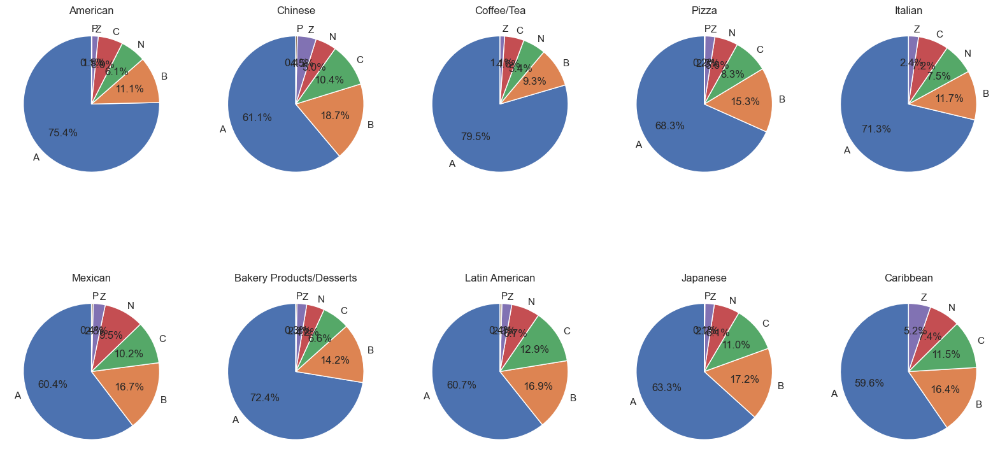

In [45]:
# Get the top 10 cuisine types with the most occurrences
top_10_types = df_test_22['CUISINE DESCRIPTION'].value_counts().head(10).index.tolist()
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(20,10))
# Loop through the top 10 cuisine types and create a pie chart for each
for i, t in enumerate(top_10_types):
     # Filter the data to only include the current cuisine type
    df_type = df_test_22[df_test_22['CUISINE DESCRIPTION'] == t]
     # Get the counts of each grade for the current cuisine type
    counts = df_type['GRADE'].value_counts()
    percentages = (counts/sum(counts))*100
     # Get the current subplot and create a pie chart for the current cuisine type
    ax = axes[i//5,i%5]
    ax.pie(percentages, labels=percentages.index, autopct='%1.1f%%', startangle=90)
    ax.set_title(t)
    
plt.savefig('10_pie_chart.png', dpi=300, bbox_inches='tight', pad_inches=0.5)

Then we looked at the inspection scores of these ten restaurants. The grade types include A, B, and C, with A representing no critical violations found during the inspection, and C representing multiple critical violations found during the inspection. The chart shows that Coffee/Tea establishments have the highest percentage of A grades, while Caribbean restaurants have the lowest percentage of A grades. On the other hand, Latin American restaurants have the highest percentage of C grades, while Coffee/Tea establishments have the lowest percentage of C grades.

It can provide insight to inspectors into which types of restaurants may need more attention during inspections. Restaurants can use this chart to compare their grade percentages to the top-performing establishments in their category and identify areas for improvement. And customers can use this information to make informed decisions about where to eat based on a restaurant's grade percentage.

Visualize the CRITICAL FLAG percentages in top 10 types of restaurant

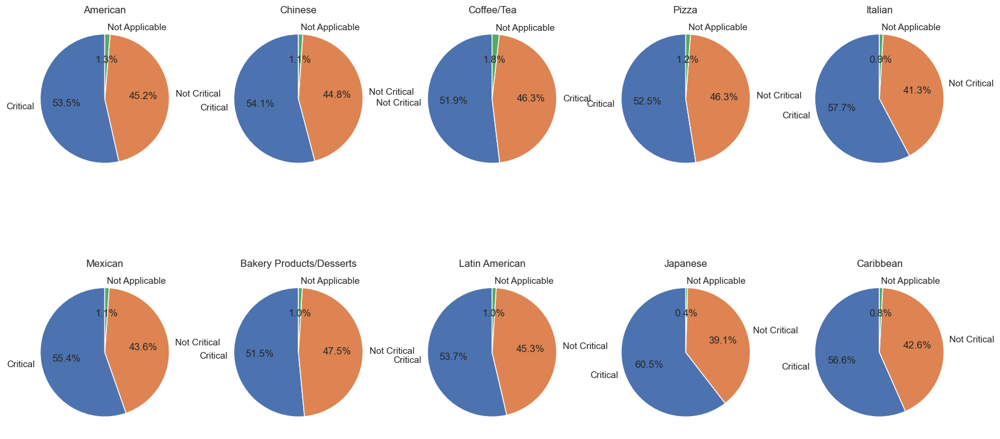

In [46]:
# Get the top 10 most common cuisine types
top_10_types = df_test_22['CUISINE DESCRIPTION'].value_counts().head(10).index.tolist()
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(20,10))
# For each of the top 10 cuisine types,
for i, t in enumerate(top_10_types):
    # Create a subset of the dataframe with rows that match the current cuisine type
    df_type = df_test_22[df_test_22['CUISINE DESCRIPTION'] == t]
    counts = df_type['CRITICAL FLAG'].value_counts()
    percentages = (counts/sum(counts))*100
    # Get the current subplot and create a pie chart with the flag percentages
    ax = axes[i//5,i%5]
    ax.pie(percentages, labels=percentages.index, autopct='%1.1f%%', startangle=90)
    ax.set_title(t)

plt.savefig('10_pie_critical_chart.png', dpi=300, bbox_inches='tight', pad_inches=0.5)

After analyzing the inspection scores, we moved to the VIOLATION DESCRIPTION types for the top 10 types of restaurants. It is evident that different types of establishments exhibit varying degrees of compliance with food safety regulations.  "Critical" violations are those that are more likely to contribute to food contamination, illness, or other health hazards. "Not Critical" violations are those that are less likely to contribute to food contamination or illness but still require correction.  "Not Applicable" means that the violation does not apply to that specific establishment or is not applicable to the inspection type. The data varies little by restaurant type. 

Basically, these three violations of all types of restaurants didn't differ much. From the chart, we can see that Japanese Restaurants are with the highest Critical crime, 60.5%. Following that, that of Italian and Caribbean is 57.7% and 56.6%. And the rest of the restaurant types are also not low, all above 50%. 'Not applicable' of all types of restaurants are all below 2%. And the 'Not critical' accounts for about 40%.

According to the chart, restaurant owners and managers should review their current procedures and consider implementing additional training or protocols to address these areas of concern. Inspectors can use this information to focus their inspections on areas of concern, such as the types of violations that are most common across the industry. And Consumers can prioritize food safety when selecting a restaurant and increase food safety awareness when going out.

Lets have a look about the Chinese restaurants distribution among boroughs in New York 

In [48]:
# load the GeoJSON file for the boroughs
with open('new-york-city-boroughs.geojson', 'r') as f:
    ny_boroughs = f.read()

# create a filtered dataframe for grade C restaurants
df_c = df_test_22[df_test_22['CUISINE DESCRIPTION']=='Chinese']

# initialise empty lists to store latitude and longitude information
lat_info = []
lng_info = []

# loop through each restaurant and append its latitude and longitude to the respective lists
for i in range(len(df_c)):
    lat = df_c.iloc[i]['Latitude']
    lng = df_c.iloc[i]['Longitude']
    # check if lat and lng are valid coordinates
    if np.isnan(lat) or np.isnan(lng):
        continue
    lat_info.append(lat)
    lng_info.append(lng)

# combine latitude and longitude information into a numpy array
data = np.array([lat_info, lng_info]).T

# create folium map and add marker cluster and heat map layers to it
cgrade_heatmap = folium.Map(location=[40.761635, -73.971802], zoom_start=12)

# add the GeoJSON layer for the boroughs
folium.GeoJson(ny_boroughs, name='Boroughs').add_to(cgrade_heatmap)

# add the marker cluster layer for grade C restaurants
plugins.MarkerCluster(data).add_to(cgrade_heatmap)

# add the heat map layer for grade C restaurants
cgrade_heatmap.add_child(plugins.HeatMap([[row['Latitude'], row['Longitude']] for name, row in df_c.iterrows()]))

# add the GeoJSON layer for the boroughs
geojson = folium.GeoJson(ny_boroughs, name='Boroughs', 
                         style_function=lambda feature: {'fillColor': 'transparent', 
                                                        'color': 'black', 
                                                        'weight': 2}, 
                         highlight_function=lambda x: {'weight':3, 'fillColor': 'grey'}, 
                         tooltip=folium.features.GeoJsonTooltip(fields=['name'], aliases=['Borough:'], 
                                                               labels=True, sticky=False))
geojson.add_to(cgrade_heatmap)

# display the map
cgrade_heatmap


This map displays the distribution of Chinese restaurants across the five boroughs of New York City. Chinese cuisine is the second most popular type of cuisine in the city, and this map provides a visual representation of where these restaurants are located. The size of the markers on the map indicates the number of Chinese restaurants in each borough, with redder color indicating more restaurants. We found that the places with a higher density of Chinese restaurants are concentrated in Manhattan, Queens, and Brooklyn.

This map can be useful for residents and visitors alike who are interested in exploring the city's diverse culinary offerings, particularly those who are fans of Chinese cuisine. 

It also provides valuable information for those who want to set up a new business, particularly in the restaurant industry. By visualizing the distribution of Chinese restaurants among the boroughs of New York, the map can help potential business owners identify areas with high demand for Chinese cuisine and potential competition in the market. Additionally, the map can also provide insights into the areas where Chinese restaurants are less prevalent, indicating potential opportunities for new businesses to fill the gap and cater to underserved markets.

## 3.4 Boros analysis<a class="anchor" id="sec3_4"></a>

In [49]:
pd.DataFrame(df_test_22.BORO.value_counts(ascending = False))

,BORO
Manhattan,7576
Brooklyn,5438
Queens,4546
Bronx,1807
Staten Island,768


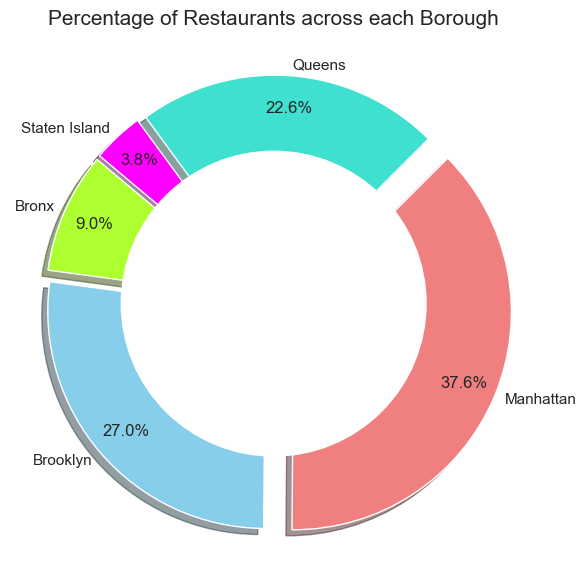

In [50]:
# Donut plot of Percentage of unique restaurants in each borough

Donut=df_test_22.groupby("BORO",as_index=False).count()

 
fig = plt.figure(figsize=[6,6]) #Enlarging the pie chart for easy viewing
ax = fig.add_subplot(111)
explode=(0.05,0.05,0.1,0.05,0.05)
colors=['greenyellow','skyblue','lightcoral','turquoise','fuchsia']
ax.axis('equal')
plotpie=plt.pie(Donut['CAMIS'],colors=colors,explode=explode,pctdistance=0.85,labels=Donut.BORO,shadow=True,autopct='%1.1f%%',startangle=140,labeldistance=1.05)
centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
ax.set_title("Percentage of Restaurants across each Borough",fontsize=15);
plt.tight_layout()
plt.show()
 

For checking the restaurant information in different boroughs. We first look at the pie chart of the percentage of restaurants across each borough. It reveals that Manhattan has the highest percentage of restaurants at 37.6%, followed by Brooklyn at 27%, Queens at 22.6%, The Bronx at 9%, and Staten Island at 3.8%. We combined the Restaurants Distribution Map to get some insights below.

The introduction of 

In [51]:
# load the GeoJSON file for the boroughs
with open('new-york-city-boroughs.geojson', 'r') as f:
    ny_boroughs = f.read()


#Initialising empty list to store latitude and longitude information
lat_info = []
lng_info = []

#Count of restaurant details which will be entered in the empty lists defined above
N = len(df_test_22)

#Loop through each restaurant and append its latitude and longitude to the respective lists
for i in range(N):
    lat = df_test_22["Latitude"].iloc[i]
    lng = df_test_22["Longitude"].iloc[i]
    # Check if lat and lng are valid coordinates
    if np.isnan(lat) or np.isnan(lng):
        continue
    lat_info.append(lat)
    lng_info.append(lng)

#Combine latitude and longitude information into a numpy array
data = np.array([lat_info, lng_info]).T

#Create folium map and add marker cluster to it
resto_map = folium.Map(location=[40.767937,-73.982155], zoom_start=10)

# add the GeoJSON layer for the boroughs
geojson = folium.GeoJson(ny_boroughs, name='Boroughs', 
                         style_function=lambda feature: {'fillColor': 'transparent', 
                                                        'color': 'black', 
                                                        'weight': 2}, 
                         highlight_function=lambda x: {'weight':3, 'fillColor': 'grey'}, 
                         tooltip=folium.features.GeoJsonTooltip(fields=['name'], aliases=['Borough:'], 
                                                               labels=True, sticky=False))
geojson.add_to(resto_map)

# add the marker cluster layer
plugins.MarkerCluster(data).add_to(resto_map)

# add the layer control to the map
folium.LayerControl().add_to(resto_map)

#Display the map
resto_map

The plot shows the distribution of restaurants across the five boroughs of New York City: Manhattan, Brooklyn, Queens, The Bronx, and Staten Island. By hovering over each borough, you can see the number of restaurants in each area. We found that the number of restaurants is directly proportional to the density of New York's population. For instance, Manhattan, which has a population density of 28,872 people per km2 (according to Wikipedia's 2021 Census), has the highest number of restaurants at 37.6%, followed by Brooklyn at 27%, Queens at 22.6%, The Bronx at 9%, and Staten Island at 3.8%. 

Combining the information of Percentage of Restaurants across each Borough, which can be useful for various stakeholders, including new restaurant owners who are looking to set up their businesses in areas with high foot traffic and customer demand. Additionally, existing restaurant owners and inspectors can use this data to make informed decisions about their operations and inspections. As for the people who want to expolre cuisine in York New, it provides a general view. For instance, Manhattan is the place for looking for authentic international cuisine. Brooklyn and Queens are also great options.

visualize how many types in each district

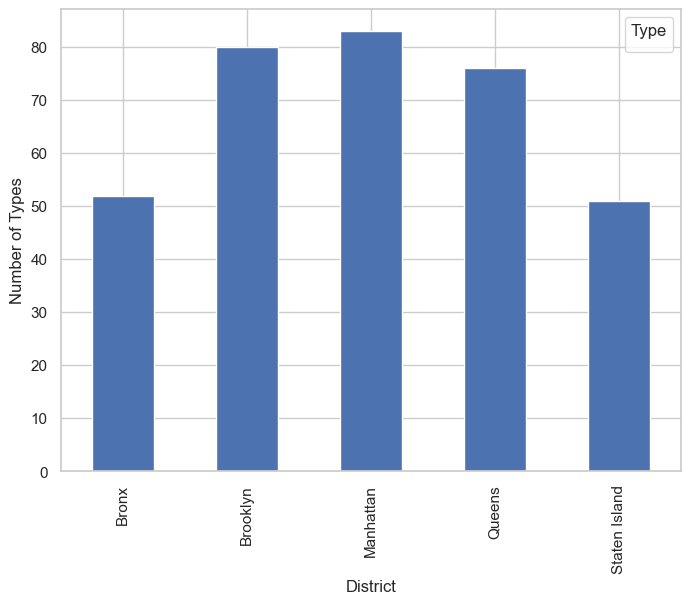

In [52]:
counts = df_test_22.groupby(['BORO','CUISINE DESCRIPTION']).size().reset_index(name='counts')
type_counts = counts.groupby(['BORO']).size()
# create a bar plot
ax = type_counts.plot(kind='bar', stacked=True, figsize=(8, 6))
ax.set_xlabel('District')
ax.set_ylabel('Number of Types')

ax.legend(labels=[], title='Type')
# show the plot
plt.show()


The bar chart above shows the number of restaurant types in different boroughs, The borough with number of types, from most to least, are Manhattan, Brooklyn, The Bronx, Queens and Staten Island, which is positively correlated with the number of restaurants in these boroughs.

The information provided in the bar chart can be useful for a wide range of stakeholders who are interested in the culinary scene in New York City. By understanding the types of restaurants that are prevalent in each borough, stakeholders can make informed decisions about their restaurant concepts, menu offerings, reviews, and exploration of the city's diverse food scene.

In [69]:
# group the data by unique grades and boroughs
counts = df_test_22.groupby(['BORO','GRADE']).size().reset_index(name='Freq')
# pivot the data to create a heatmap
pivot_boro_grade = pivot = counts.pivot(index = "GRADE", columns = "BORO", values = "Freq")

In [70]:
pivot_boro_grade

BORO,Bronx,Brooklyn,Manhattan,Queens,Staten Island
GRADE,,,,,
A,1115.0,3781.0,5443.0,3139.0,556.0
B,314.0,722.0,906.0,628.0,136.0
C,169.0,420.0,561.0,382.0,33.0
N,146.0,333.0,483.0,285.0,31.0
P,3.0,12.0,8.0,10.0,NaN
Z,60.0,170.0,175.0,102.0,12.0


In [71]:
# create a ColumnDataSource object from the pivoted data
source = ColumnDataSource(pivot_boro_grade)
output_notebook()

Loading BokehJS ...

In [72]:
# create the figure
p = figure(x_range=FactorRange(factors=pivot_boro_grade.index),
           plot_width=1200,
           title='Crimes By year', 
           x_axis_label='Grade', 
           y_axis_label='Number of restaurants')

In [73]:
# define the color map
cmap = sns.color_palette('icefire', len(pivot_boro_grade.columns)).as_hex()

In [74]:
# create a list of unique boroughs in the dataframe
district_lsit = list(df_test_22['BORO'].unique())

In [75]:
# create a dictionary of bars and a list of legend items
bar = {}
items = []

for i, district in enumerate(district_lsit):
    bar[district] = p.vbar(x='GRADE', 
                    top=district, 
                    source=source, 
                    width=0.7,
                    color=cmap[i],
                    fill_alpha=1.5,
                    muted=True, 
                    muted_alpha=0.005) 
    items.append((district, [bar[district]]))
    
p.xaxis.major_label_orientation = 1
p.y_range.start = 0

In [77]:
# customize the plot
p.xaxis.major_label_orientation = 1
p.y_range.start = 0
legend = Legend(items=items)
p.add_layout(legend, 'left')    
p.legend.click_policy = 'mute'

# save the plot as HTML
save(p)

'C:\\Users\\geng8\\AppData\\Local\\Temp\\tmp7vgjwxwy.html'

Then, we created the interactive bar chart shows the distribution of violation grades across the five boroughs of New York City: Manhattan, Brooklyn, Queens, The Bronx, and Staten Island. The x-axis represents the different violation grades, including A, B, C, N, P, and Z, while the y-axis represents the number of restaurants that received each grade. By clicking on each borough label, you can see the violation grade distribution for that specific area and compare the data between the boroughs.

We found that Grade A violations are the most common among all boroughs, while Grades B and C are less frequent but not rare, indicating that there is more room for improvement in food safety practices in certain areas.

Restaurant owners can use this data to benchmark their own food safety practices against the average for their borough or the city as a whole. They can identify areas where they may need to improve and take corrective action to ensure compliance with food safety regulations.


For inspectors, this information can be used to target their inspections more effectively by focusing on areas with a higher prevalence of lower-grade violations. This will help them to allocate their resources more efficiently and ensure that restaurants are meeting the required standards.

Customers can also use this information to make more informed decisions about where to eat. By checking a restaurant's violation grade before dining, they can ensure that they are eating at a place that prioritizes food safety and hygiene. This can help to prevent foodborne illnesses and ensure a positive dining experience.



Let us have a look about restaurants distribution with grade is C

In [78]:
# load the GeoJSON file for the boroughs
with open('new-york-city-boroughs.geojson', 'r') as f:
    ny_boroughs = f.read()

# create a filtered dataframe for grade C restaurants
df_c = df_test_22[df_test_22['GRADE']=='C']

# initialise empty lists to store latitude and longitude information
lat_info = []
lng_info = []

# loop through each restaurant and append its latitude and longitude to the respective lists
for i in range(len(df_c)):
    lat = df_c.iloc[i]['Latitude']
    lng = df_c.iloc[i]['Longitude']
    # check if lat and lng are valid coordinates
    if np.isnan(lat) or np.isnan(lng):
        continue
    lat_info.append(lat)
    lng_info.append(lng)

# combine latitude and longitude information into a numpy array
data = np.array([lat_info, lng_info]).T

# create folium map and add marker cluster and heat map layers to it
cgrade_heatmap = folium.Map(location=[40.761635, -73.971802], zoom_start=12)

# add the GeoJSON layer for the boroughs
folium.GeoJson(ny_boroughs, name='Boroughs').add_to(cgrade_heatmap)

# add the marker cluster layer for grade C restaurants
plugins.MarkerCluster(data).add_to(cgrade_heatmap)

# add the heat map layer for grade C restaurants
cgrade_heatmap.add_child(plugins.HeatMap([[row['Latitude'], row['Longitude']] for name, row in df_c.iterrows()]))

# add the GeoJSON layer for the boroughs
geojson = folium.GeoJson(ny_boroughs, name='Boroughs', 
                         style_function=lambda feature: {'fillColor': 'transparent', 
                                                        'color': 'black', 
                                                        'weight': 2}, 
                         highlight_function=lambda x: {'weight':3, 'fillColor': 'grey'}, 
                         tooltip=folium.features.GeoJsonTooltip(fields=['name'], aliases=['Borough:'], 
                                                               labels=True, sticky=False))
geojson.add_to(cgrade_heatmap)

# display the map
cgrade_heatmap


From the map above, we see the distribution of the restaurants with crime type C. The distribution of it is positively correlated with the all restaurant distribution map. Due to the fact that C crimes are the most serious crime type and would threaten customer safety. We suggest that inspectors can increase their inspection of densely populated areas and strengthen legal awareness publicity for restaurants.

The map above provides valuable information for inspectors to target their inspections more effectively. Inspectors should focus their efforts on areas with a high prevalence of C violations, especially densely populated areas. They should also increase legal awareness publicity to ensure that restaurant owners are aware of their responsibilities and comply with food safety regulations. Customers can also play a role in ensuring food safety by being vigilant when dining out. They should check a restaurant's violation history before dining and report any suspicious practices or unsanitary conditions to the authorities. 

## 3.5 Violations analysis<a class="anchor" id="sec3_5"></a>

We further analyzed the violation data to better understand the common food safety issues in New York City restaurants and provide targeted recommendations for improvement. Here, we present the findings from our violation analysis.

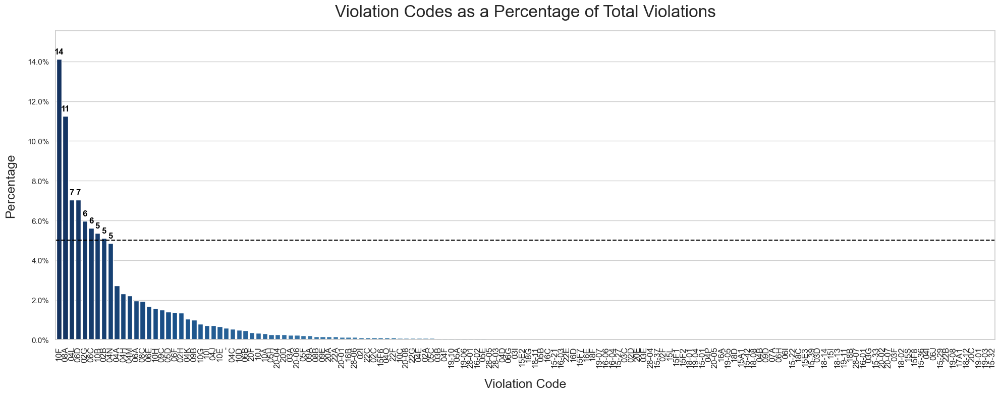

In [79]:
# Calculate violation frequencies
tmp = df.groupby(["VIOLATION CODE"]).size().sort_values(ascending=False).reset_index(name="count")
tmp['Freq'] = tmp["count"]/tmp["count"].sum()*100

# Set color palette
palette = sns.color_palette("Blues_r", len(tmp))

# Set plot style
sns.set_style("whitegrid")

# Create figure and axes objects
fig, ax = plt.subplots(figsize=(20, 8))

# Plot violation percentages
sns.barplot(x="VIOLATION CODE", y="Freq", data=tmp, ax=ax, palette=palette)

# Set title and axis labels
ax.set_title("Violation Codes as a Percentage of Total Violations", fontsize=24, pad=20)
ax.set_xlabel("Violation Code", fontsize=18, labelpad=15)
ax.set_ylabel("Percentage", fontsize=18, labelpad=15)

# Rotate x-axis labels and set y-axis limits and formatter
plt.xticks(rotation=90, fontsize=12)
ax.set_ylim([0, max(tmp["Freq"])*1.1])
ax.yaxis.set_major_formatter(PercentFormatter(xmax=100, decimals=1))



# Add annotations to the bars
for i, bar in enumerate(ax.containers[0]):
    height = bar.get_height()
    if height >= 3:
        ax.annotate(f'{height:.0f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 5),
                    textcoords='offset points',
                    ha='center',
                    va='bottom',
                    fontsize=12,
                    fontweight='bold',
                    color='black')

# Add horizontal line to highlight 5% threshold
ax.axhline(y=5, color='black', linestyle='--')


# Save and show the plot
plt.tight_layout()

plt.show()


The chart above displays the percentage of violation codes found in New York City restaurants. The top five violation codes are 10F, 08A, 04L, 06D, and 02G, which account for more than 40% of all violations. The most common violations are related to improper construction or maintenance of non-food contact surfaces, conditions conducive to rodents, evidence of mice, improper sanitation of food contact surfaces, and improper holding temperatures of cold TCS food items. These violations can pose serious health risks to consumers and can result in the closure of restaurants.

In light of these common violations, we suggest the following strategies for the key stakeholders:

1. Regulatory authorities:
   - Target interventions and inspection efforts to address these common violations, offering additional training and resources to restaurant owners and staff.
   - Implement effective pest control plans, staff training on proper sanitation and storage techniques, and monitoring of non-food contact surfaces and equipment for proper maintenance and cleaning.

2. Customers:
   - Make informed dining choices by looking up inspection results online and reporting any food safety concerns to the appropriate authorities.
   - Prioritize dining at establishments with fewer or less severe violations to encourage higher food safety standards across the industry.

3. Restaurant owners:
   - Prioritize staff training and monitoring to prevent these common violations, focusing on proper sanitation, storage, and maintenance practices.
   - Implement regular cleaning schedules for non-food contact surfaces and equipment, and ensure that cold TCS food items are held at appropriate temperatures.

After examining the most common food safety violations found in New York City restaurants, we will now explore potential seasonal variations in these violations. Identifying any seasonal trends can help regulatory authorities and restaurant owners tailor their strategies and interventions to address specific issues that may arise during certain times of the year. In the next chart, we will analyze the top five violation codes for each season to uncover any notable differences or patterns.

In [80]:
# group by season and violation code and calculate the count and frequency
tmp = df_test_22.groupby(["SEASON","VIOLATION CODE"]).size().sort_values(ascending=False).reset_index(name="count")
tmp['Freq'] = tmp["count"]/tmp.groupby('SEASON')['count'].transform('sum')*100

# create the interactive bar chart
fig = px.bar(tmp, x="VIOLATION CODE", y="Freq", color="SEASON",
             labels={'VIOLATION CODE': 'Violation Code', 'Freq': 'Percentage'},
             title='Violation codes as %age of total violations by season',
             barmode='group')

# customize the layout
fig.update_layout(
    xaxis=dict(title='Violation Code', showgrid=False, tickangle=-45, tickfont=dict(size=10)),
    yaxis=dict(title='Percentage', showgrid=False),
    legend=dict(title='Season', orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1),
    plot_bgcolor='rgba(0,0,0,0)',
    font=dict(family='Helvetica', size=12),
    title=dict(font=dict(size=16)),
    hovermode='closest'
)

# customize the hover text
fig.update_traces(hovertemplate='<b>Violation Code:</b> %{x}<br><b>Percentage:</b> %{customdata:.2f}%<extra></extra>', 
                  customdata=tmp['Freq'])

# add a horizontal line at 25%
fig.add_trace(go.Scatter(x=[-0.5, len(tmp['VIOLATION CODE'].unique())-0.5], y=[25, 25],
                         mode='lines', name='25%', line=dict(color='red', dash='dash')))

fig.show()


The chart above presents the top five violation codes in each season, highlighting potential seasonal variations in food safety violations. Violations related to non-food contact surfaces, pests, and temperature control (such as codes 10F, 06D, 08A, and 02G) appear in the top five for all four seasons, indicating the need for year-round attention and prevention measures. Violation code 04N, which relates to filth flies, appears in the top five for fall. Code 04L, which relates to evidence of mice or live mice, appears in the top five for winter. These results suggest that regulatory authorities and restaurant owners should prioritize preventative measures that address year-round risks, such as effective pest control and regular cleaning and maintenance of non-food contact surfaces and equipment. Additionally, seasonal inspections could target specific issues that may arise during certain times of the year, such as pest control during the fall season.

Having identified potential seasonal variations in food safety violations, we will now shift our focus to understanding the severity of these violations. Knowing which violations are considered critical can help regulatory authorities prioritize inspections and interventions, while restaurant owners can address the most pressing food safety issues. In the following chart, we will examine the distribution of critical and non-critical violations in the dataset.

In [81]:
flags = df[df['CRITICAL FLAG'].isin(['Critical', 'Not Critical'])]
counts = flags['CRITICAL FLAG'].value_counts(normalize=True)

fig = go.Figure(data=[go.Bar(
    x=counts.index, 
    y=counts.values,
    marker=dict(color=['blue', 'orange'])
)])

fig.update_layout(
    title='Distribution of Critical Flags',
    xaxis_title='Flag',
    yaxis_title='Percentage',
    hovermode='closest',
    yaxis_tickformat = '%',
)

fig.update_traces(
    hovertemplate='%{y:.2%}',
)

fig.show()


The chart above shows that 56.05% of the violations in the dataset were classified as critical by inspectors, while 43.95% were classified as not critical. This information is useful for regulatory authorities in understanding the severity of the violations found in restaurants and can guide their inspection priorities and intervention strategies. For restaurant owners, it is important to prioritize the correction of critical violations as they pose a higher risk to public health and can result in more severe penalties, including closure.

After exploring the distribution of critical and non-critical violations, it is essential to understand how these classifications relate to different restaurant grades. This information can help both regulatory authorities and restaurant owners to recognize areas that require improvement and to develop targeted strategies for enhancing food safety standards. In the next chart, we will analyze the distribution of critical flags across different grades of restaurants to uncover any significant trends or relationships.

In [82]:
# Filter the data by grade and critical flag
grade = ['C', 'B', 'A']
tmp = df[df['GRADE'].isin(grade) & df['CRITICAL FLAG'].isin(['Critical', 'Not Critical'])]

# Calculate the counts and frequencies of each critical flag by grade
counts = tmp.groupby(['GRADE','CRITICAL FLAG']).size().reset_index(name="counts")
counts["Freq"] = counts["counts"]/counts.groupby(['GRADE'])["counts"].transform('sum')

# Create a bar chart with hover text showing the percentage of critical flags
fig = go.Figure()
for flag in counts['CRITICAL FLAG'].unique():
    data = counts[counts['CRITICAL FLAG'] == flag]
    fig.add_trace(go.Bar(
        x=data['GRADE'],
        y=data['Freq'],
        name=flag,
        hovertemplate="%{y:.2%}",
    ))

# Update the layout with title and axis labels
fig.update_layout(
    title='Distribution of Critical Flags by Grade',
    xaxis_title='Grade',
    yaxis_title='Percentage of Critical Flags',
    hovermode='closest',
    barmode='stack',
)

# Display the plot
fig.show()


The chart above provides insights into the distribution of critical flags across different grades of restaurants. The data shows that critical violations are more common than non-critical violations across all grades, with the proportion of critical violations increasing as the grade decreases. This suggests that lower graded restaurants may have more serious food safety issues that require immediate attention from regulatory authorities.

In conclusion, our violation analysis reveals the most common food safety issues in New York City restaurants and offers targeted recommendations for improvement. By working together, regulatory authorities, customers, and restaurant owners can promote a culture of food safety and prevent health risks to consumers. By addressing common violations, prioritizing year-round and seasonal preventative measures, and focusing on critical violations, stakeholders can work together to elevate the overall industry standards. Through support, guidance, and collaboration, the food service sector can foster a culture of continuous improvement and maintain high-quality dining experiences for customers.

# 4. Genre <a class="anchor" id="sec4"></a>

Different genres and supporting tools can be used to capture and retain the readers' attention while narrating a data story. Edward Segel and Jeffrey Heer offer various techniques and resources for data storytelling. Since data is a supplement to conventional storytelling, diverse mechanisms need to be employed (Segel & Heer, 2010) to create an effective and engaging data story.

### Visual Narrative


**Visual Structuring**

The primary goal of visual structuring is to establish a Consistent Visual Platform that maintains simplicity and creates coherence throughout the project.By utilizing uniform colors, layouts, and plot setups, a clear structure is formed that enhances the viewer's experience and ensures seamless transitions between each section. This strategy not only fosters viewer engagement but also facilitates the effective communication of the project's message.

**Highlighting**

To draw attention to important information, the project utilizes tool: Zooming and Feature Distinction. This techniques are applied to more complex figures and maps, and Feature Distinction is particularly effective in highlighting noteworthy points in plots. By doing so, the viewers are engaged more deeply in the project, and they are given the opportunity to explore and experiment with the features to gain a more comprehensive understanding of the project. For instance, a heatmap was employed to visualize the distribution of restaurants with a C grade in New York City, providing users with a visual representation of the patterns. This approach facilitates the users' ability to discern important insights from the data and enhances their overall experience of the project.

**Transition Guidance**

Using interaction tool can help to provide viewers with more information or allow them to interact with the data in new ways. For example, allowing viewers to click on a borough to see more information about its inspection history can help to create a more engaging and informative visualization.

### Narrative Structure

**Ordering**

The project is structured in a Linear order, which is ideal for presenting a cohesive and interconnected story with the data. This approach starts with an introduction to the project's purpose and follows with an overview of the data patterns. By employing a linear narrative, the reader is guided through the project in a deliberate and coherent manner. As the reader scrolls down the page, they are directed through the story we aim to tell while also having the freedom to explore on their own. This approach allows the reader to engage with the content at their own pace and encourages them to develop a deeper understanding of the project's message.

**Interactivity**


To enhance the viewer's engagement with the project, Hover highlighting, Selection, and Navigation Buttons have been incorporated into more complex figures and maps. This approach enables users to interact with the data on multiple levels, thereby increasing their engagement and encouraging them to explore the project's details and themes more deeply. By incorporating multiple features and tools, users are given the opportunity to interact with the project on their terms, allowing them to gain a deeper understanding of the project's message and enhancing their overall experience of the project.

**Messaging**

To provide context and introduce the problem to the user, the project employed an introductory text at the top of the website. Furthermore, to bring the story to a close, the Summary/Synthesis category was incorporated at the end of the project. By including these sections, the project was able to bookend the story, providing a clear and comprehensive narrative for the user to follow. This approach not only enhances the user's understanding of the project but also fosters greater engagement and facilitates the effective communication of the project's message.

# 5. Visualizations <a class="anchor" id="sec5"></a>

We utilized diverse range of visualization tools during the NYC Restaurant Inspections analysis

**Bar Chart**

One important and frequently used visualization tool in our project is the bar chart. This tool not only provides an overview of the data, but also allows for clear and concise reasoning behind the visuals. For instance, we utilized bar charts to depict the yearly pattern of inspection counts. The primary reason for the extensive use of bar charts in our project is that they present the results from data in a simple and easy-to-understand way for the reader. 

**Interactive bar charts**

To avoid clutter and enhance user engagement, we suggest exploring options such as combining multiple factors into one and making them interactive. This is particularly relevant for projects that involve a large number of bars, which can take up considerable space. In our research, we have utilized interactive bar charts extensively, as we believe that they give readers more freedom to explore the data without being overwhelmed by a lot of information. With interactive charts, readers can choose what they want to look at, which can facilitate a more intuitive and engaging user experience.

**Pie chart**

Pie charts are a useful way to visualize proportions or percentages of a whole. In the context of NYC restaurant inspections analysis, pie charts can be used to show the distribution of inspection results across different categories, such as the percentage of restaurants that received a grade A, B, or C. By using a pie chart in this analysis, we can quickly and easily convey the overall distribution of inspection results to readers. Pie charts can also be useful for comparing different categories or subsets of data within the same whole. . 

**Box plots**

By using a box plot in this analysis, we can quickly and easily convey the overall distribution of inspection scores to readers.The box in the plot represents the middle 50% of the data, with the median line dividing the box into two halves.By examining the box plot, stakeholders can easily identify the median inspection score, as well as the range and variability of scores within each category. 

**Folium maps**

Folium maps are the final category of visualization tools used in this project. These maps provide an overview of the distribution of restaurants and include various elements to help readers understand where the focus of the study is currently headed. For instance, we use a folium map to display the distribution of C grade restaurants across New York City. The color of area on the map is darker where C grade restaurants are more densely located. The folium maps provide an additional visual aspect that engages the reader and enhances their understanding of the data being analyzed. The map and color scheme used in the folium maps are directly connected to the plots used later in the paper. Readers can click on the map to access additional information about each part of the study and when it was completed. This tool enables readers to gain an overview of an aspect and situation that will be explained and examined in the next section, thus enhancing their involvement in the study.

# 6. Discussion <a class="anchor" id="sec6"></a>

We performed a thorough data cleaning, exploration, and analysis of several datasets and created interactive visualizations to present our main findings. Our project scope gradually narrowed down as we aimed to communicate a clear message through our website. Despite the limitations in our data, we were able to draw meaningful insights about inspections results in New York City. For instance, we gained insights into the overall inspections results and identified which types of restaurants should be prioritized for inspections. We also identified the best locations to find clean food, among other insights. Our ability to draw actionable insights from the data demonstrates the reliability of our analysis, which was a concern at the start of the project.

While we were able to draw useful insights from our analysis, we recognize that our dataset had some limitations. One of the biggest challenges was the uneven distribution of data across the years. The data prior to 2019 was significantly smaller, representing less than 10% of the inspections in 2019. We suspect that this may be due to incomplete reporting mechanisms, resulting in many inspections not being entered into the system. Additionally, the number of inspections conducted in 2019 and 2020 were relatively low, likely due to the impact of the COVID-19 pandemic.As a result, it was difficult for us to draw meaningful trends over the years. For instance, analyzing the number of C-grade restaurants by boroughs may be problematic, as the incomplete data could give the false impression that the number of C-grade restaurants has increased over time.While our analysis was still able to provide valuable insights, these limitations should be taken into consideration when interpreting our results.

Although our analysis identified areas with low restaurant density suitable for a new restaurant venture, location alone is not enough to make a recommendation.We also want to consider other dimensions such as population density or income level of the residents in a particular area. These factors can significantly impact the success of a new restaurant business. For example, an area with a high population density but low income levels may not be a suitable location for a high-end restaurant. Similarly, an area with a low population density but high-income levels may be more suitable for a niche cuisine type restaurant.Moreover, accessibility, parking availability, and foot traffic are other crucial factors that can influence the success of a new restaurant, although they can be challenging to quantify and analyze. However, our dataset is not sufficient to provide a comprehensive analysis and insights on these factors. Nonetheless, we believe that this is an interesting direction for future research. Perhaps by combining our dataset with other relevant data, we could gain more complete insights and provide better recommendations for launching a new restaurant.

This experience has been tremendously beneficial for us. It provided us with an opportunity to apply the analytical skills we have acquired thus far and challenged us to expand our knowledge to achieve our goals. This project marks just the beginning of our journey towards becoming proficient data analysts, and we're eager to take on more projects like this in the future. We're excited to continue growing our expertise and learning more about how we can use data to solve complex problems.

# 7. Contributions <a class="anchor" id="sec7"></a>

**Notebook:**
* 1. Motivation: *ZiWei, XingGuang*
* 2. Basic stats: *XingGuang*
* 3. Data Analysis
    * 3.1 Scores analysis: *JiaXin, XingGuang*
    * 3.2 Grades analysis: *JiaXin, XingGuang*
    * 3.3 Restaurants analysis: *ZiWei, XingGuang*
    * 3.4 Boros analysis: *ZiWei, XingGuang*
    * 3.5 Violations analysis *JiaXin, XingGuang*
* 4. Genre: *XingGuang*
* 5. Visualisations: *JiaXin*
* 6. Discussion: *XingGuang, ZiWei* 

**Website:** *XingGuang, JiaXin, ZiWei*